In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random

In [2]:
DatabaseDF = pd.read_csv("../CleanedDataset.csv")

DatabaseDF.head()

,Unnamed: 0,Operator,Well Name,Formation,Lateral Length,Stages,Township,Range,Section,"Total Prop, lbs",...,Fluid Type from DI,SPACING_CAPPED,12 month Cum Prod,Completion Type,Sleeves,P&P,Frac Ports,Repeater Ports,CT,Year Drilled
0,0,Operator 1,Well 1,MBH,5114.0,30.0,141,99,10,0.0,...,NaN,660.0,33.55,NaN,NaN,NaN,NaN,NaN,NaN,2006.0
1,1,Operator 2,Well 2,MBH,5181.0,NaN,142,99,16,418000.0,...,NaN,660.0,27.62,NaN,NaN,NaN,NaN,NaN,NaN,2005.0
2,2,Operator 2,Well 3,MBH,4780.0,15.0,142,99,24,568407.0,...,NaN,660.0,11.19,OH,NaN,NaN,NaN,NaN,NaN,2006.0
3,3,Operator 1,Well 4,MBH,10654.0,1.0,142,99,1,845000.0,...,NaN,660.0,27.85,NaN,NaN,NaN,NaN,NaN,NaN,2007.0
4,4,Operator 2,Well 5,MBH,5209.0,1.0,142,99,35,297366.0,...,NaN,660.0,50.88,OH,NaN,NaN,NaN,NaN,NaN,2006.0


## Definition

Voroni Diagrams are useful for determining information about an area given only a finite ammount of data points in that area. For every point on a plane it determines what the closest data point is and inherits that points informaiton, allowing us to make assumptions about locations where we do not have exact data but can use the closest known point

In [3]:
''' Probably best used for location looking for area. Closest Known Point of a feature based on location factors. '''

' Probably best used for location looking for area. Closest Known Point of a feature based on location factors. '

## Voronoi Function

In [4]:
from scipy.spatial import Voronoi, voronoi_plot_2d, distance
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.colors as mcolors

In [5]:
def voronoiPlot(dataframe = DatabaseDF, var = '12 month Cum Prod', colorDictionary = None):

    # generate data/speed values
    points = dataframe[['Longitude','Latitude']]
    values = dataframe[var]

    # generate Voronoi tessellation
    vor = Voronoi(points)

    if (colorDictionary is None):
        # find min/max values for normalization
        minima = min(values)
        maxima = max(values)

        # normalize chosen colormap
        norm = mpl.colors.Normalize(vmin=minima, vmax=maxima, clip=True)
        mapper = cm.ScalarMappable(norm=norm, cmap='OrRd')

    # plot Voronoi diagram, and fill finite regions with color mapped from speed value
    fig = voronoi_plot_2d(vor, show_points=False, show_vertices=False, s=1, line_width = 1, line_alpha = 0)

    fig.set_size_inches((15,10))

    for r in range(len(vor.point_region)):
        region = vor.regions[vor.point_region[r]]
        if not -1 in region:
            polygon = [vor.vertices[i] for i in region]
            if (colorDictionary is None):
                plt.fill(*zip(*polygon), color=mapper.to_rgba(values[r]))
            else:
                plt.fill(*zip(*polygon), color=colorDictionary[values[r]])

    plt.show()
''' I think this is a very good code. makes it easier to plot the graph on particular variable '''

In [6]:
def createColorDictionary(ObjectList):
    colorDict = {}

    colorL = list(mcolors.TABLEAU_COLORS.keys())
    colorL.remove('tab:brown')
    colorL.remove('tab:gray')

    for i in range(len(ObjectList)):
        colorDict[ObjectList[i]] = colorL[i % len(colorL)]

    return colorDict

## Plotting Voronoi Graphs

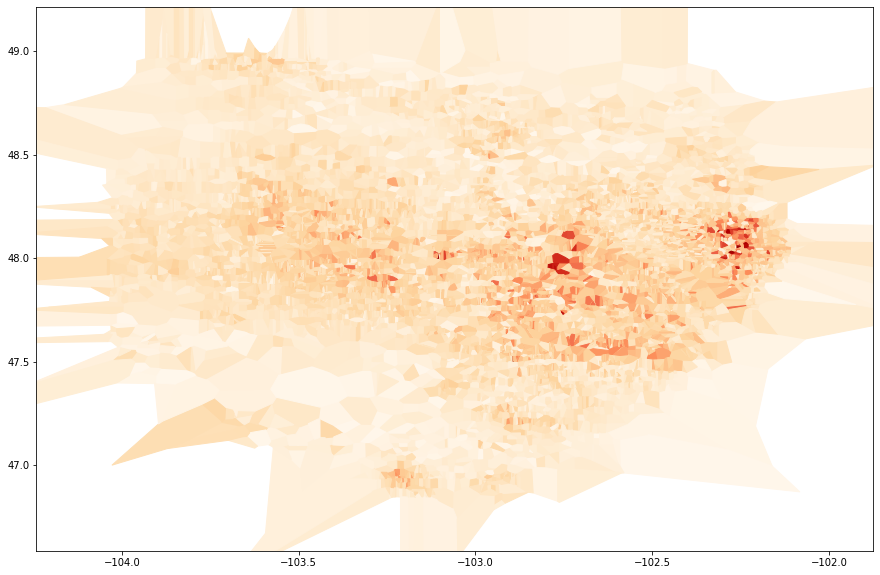

In [7]:
voronoiPlot()

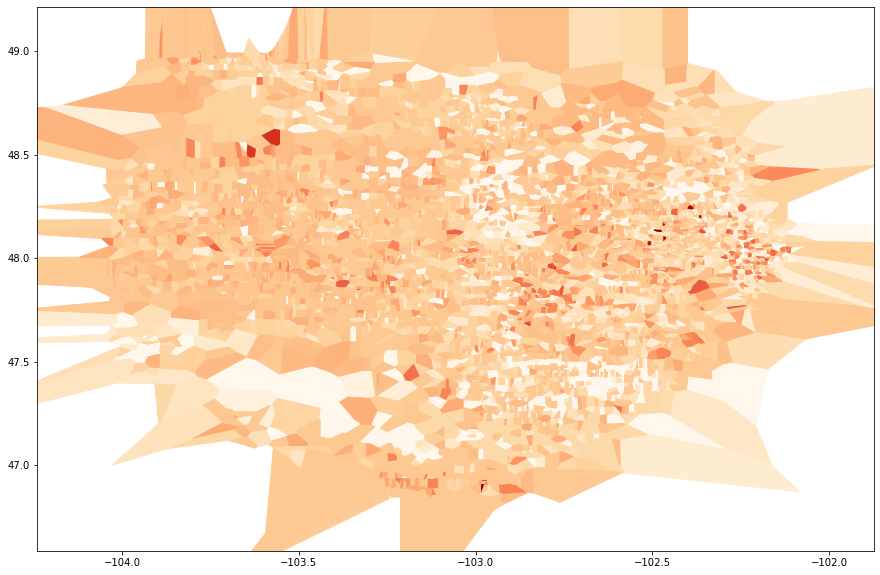

In [12]:
voronoiPlot(var = 'Stages')

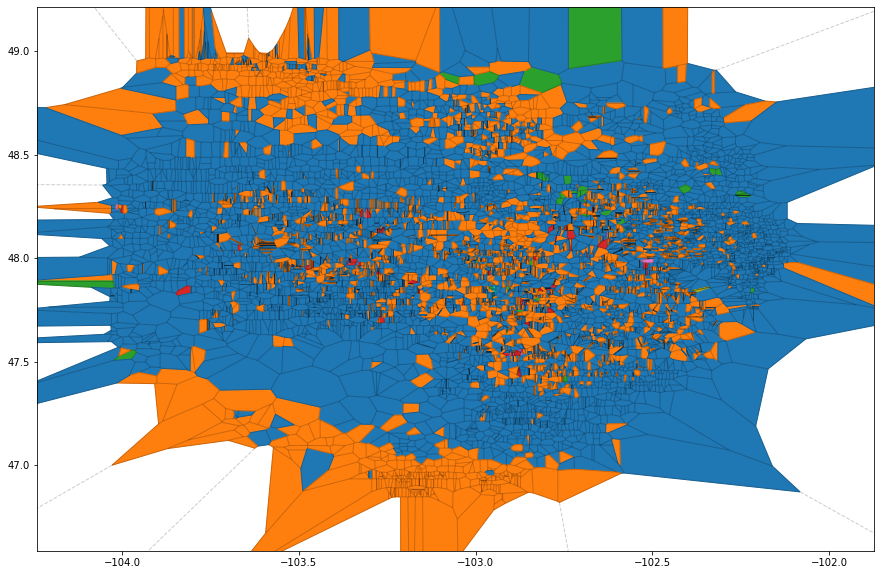

In [8]:
formationColorDict = createColorDictionary(DatabaseDF['Formation'].unique())
voronoiPlot(var = 'Formation', colorDictionary = formationColorDict)

In [8]:
''' Maybe having a legend for the color dictionary could help analyze the information. And help with something like Correlation and/or Error. '''

' Maybe having a legend for the color dictionary could help analyze the information. And help with something like Correlation and/or Error. '

## Closest point Function

In [53]:
def getClosestWell(dataframe = DatabaseDF, long = 0, lat = 0):
    points = dataframe[['Longitude','Latitude']]
    point = [long, lat]

    print(dataframe.loc[distance.cdist([point], points)[0].argmin()])


This function does what the Voronoi plot does but instead of graphing it, it returns the well that is closest to a given point. That means if you wanted to impute some data you could use the above function to gain more points of data using the same methodology of the Voronoi plot. This seems like the most usefull aspect of the Voronoi plot since it is the only part that gives us real tangable data. The plot itself is a cool vizualiation however that could enhance a presentation